In [7]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
import numpy as np
import plotly.express as px
from pandas.plotting import parallel_coordinates
import warnings
warnings.filterwarnings('ignore')

In [8]:
df = pd.read_csv('quality_of_life_indices_by_country.csv')

In [9]:
df.head(10)

,Rank,Country,Quality of Life Index,Purchasing Power Index,Safety Index,Health Care Index,Cost of Living Index,Property Price to Income Ratio,Traffic Commute Time Index,Pollution Index,Climate Index
0,NaN,Luxembourg,220.1,184.3,65.8,75.2,64.8,8.6,27.0,23.3,82.6
1,NaN,Netherlands,211.3,134.5,73.1,79.3,60.5,7.7,23.5,21.6,87.2
2,NaN,Denmark,209.9,137.3,74.0,78.4,66.9,6.5,27.8,20.6,82.5
3,NaN,Oman,208.9,153.8,81.7,65.1,39.8,3.1,22.1,35.6,67.2
4,NaN,Switzerland,205.0,164.8,73.5,71.5,98.4,11.0,33.0,23.1,79.2
5,NaN,Finland,203.8,127.6,73.2,77.5,58.7,8.0,25.5,11.8,58.6
6,NaN,Iceland,202.0,127.9,74.3,67.6,83.4,6.7,21.4,16.0,68.8
7,NaN,Norway,195.0,122.7,67.0,75.6,69.0,8.4,26.4,18.3,68.5
8,NaN,Qatar,193.3,185.7,84.2,73.4,47.5,5.2,29.0,60.0,36.0
9,NaN,Sweden,193.2,133.8,52.0,68.3,54.2,7.7,28.7,17.6,76.5


In [10]:
df.describe()

,Rank,Quality of Life Index,Purchasing Power Index,Safety Index,Health Care Index,Cost of Living Index,Property Price to Income Ratio,Traffic Commute Time Index,Pollution Index,Climate Index
count,0.0,88.000000,88.000000,88.000000,88.000000,88.000000,88.000000,88.000000,88.000000,88.000000
mean,NaN,144.025000,81.543182,59.561364,64.745455,42.687500,13.213636,35.350000,52.934091,78.520455
std,NaN,39.067296,42.546339,13.845713,9.892699,15.853973,6.820594,8.603955,20.561726,16.104709
min,NaN,21.500000,11.100000,19.300000,38.700000,17.800000,3.100000,21.400000,11.800000,20.200000
25%,NaN,117.125000,45.875000,51.950000,58.075000,30.000000,8.675000,28.975000,35.450000,68.475000
50%,NaN,141.000000,76.600000,58.850000,65.150000,40.150000,12.250000,35.000000,57.350000,81.500000
75%,NaN,174.650000,113.325000,70.625000,72.275000,54.125000,15.125000,39.425000,69.100000,91.500000
max,NaN,220.100000,185.700000,84.500000,86.500000,98.400000,45.700000,65.300000,89.400000,99.900000


In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 88 entries, 0 to 87
Data columns (total 11 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Rank                            0 non-null      float64
 1   Country                         88 non-null     object 
 2   Quality of Life Index           88 non-null     float64
 3   Purchasing Power Index          88 non-null     float64
 4   Safety Index                    88 non-null     float64
 5   Health Care Index               88 non-null     float64
 6   Cost of Living Index            88 non-null     float64
 7   Property Price to Income Ratio  88 non-null     float64
 8   Traffic Commute Time Index      88 non-null     float64
 9   Pollution Index                 88 non-null     float64
 10  Climate Index                   88 non-null     float64
dtypes: float64(10), object(1)
memory usage: 7.7+ KB


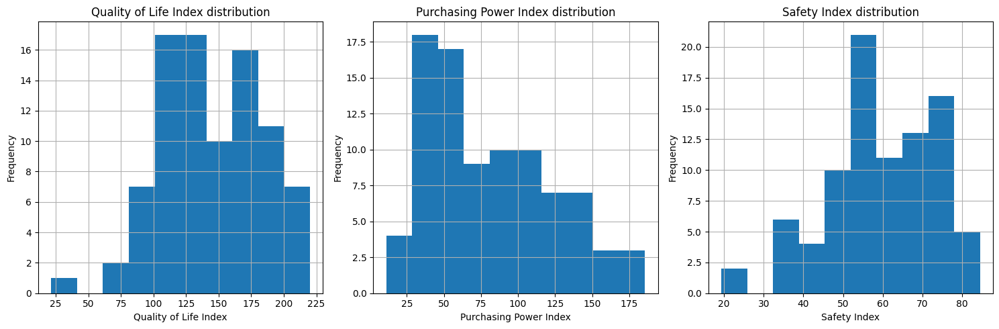

In [12]:
columns_to_plot = ['Quality of Life Index', 'Purchasing Power Index', 'Safety Index']

fig, axes = plt.subplots(1, len(columns_to_plot), figsize=(15, 5))

for i, col in enumerate(columns_to_plot):
    df[col].hist(ax=axes[i])
    axes[i].set_xlabel(col)
    axes[i].set_ylabel('Frequency')
    axes[i].set_title(f'{col} distribution')


plt.tight_layout()
plt.show()

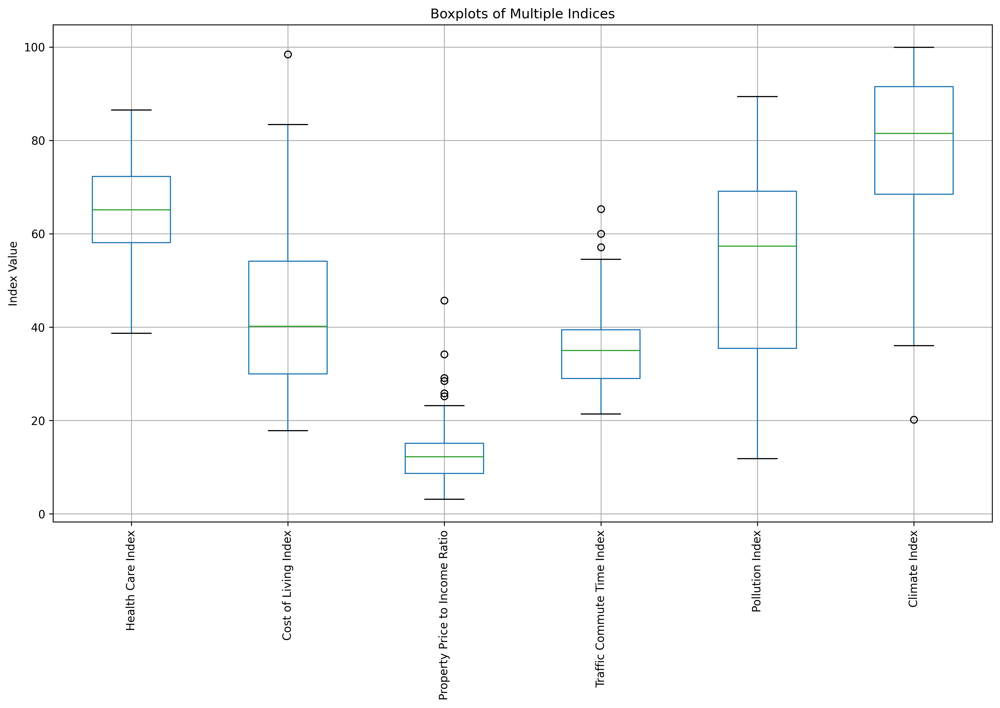

In [13]:
columns = ['Health Care Index','Cost of Living Index','Property Price to Income Ratio','Traffic Commute Time Index','Pollution Index','Climate Index']

plt.rcParams['figure.dpi'] = 300

plt.figure(figsize=(15, 8))

df[columns].boxplot()

plt.title('Boxplots of Multiple Indices')
plt.ylabel('Index Value')

plt.xticks(rotation=90)

plt.show()

Index(['featurecla', 'scalerank', 'LABELRANK', 'SOVEREIGNT', 'SOV_A3',
       'ADM0_DIF', 'LEVEL', 'TYPE', 'TLC', 'ADMIN',
       ...
       'FCLASS_TR', 'FCLASS_ID', 'FCLASS_PL', 'FCLASS_GR', 'FCLASS_IT',
       'FCLASS_NL', 'FCLASS_SE', 'FCLASS_BD', 'FCLASS_UA', 'geometry'],
      dtype='object', length=169)


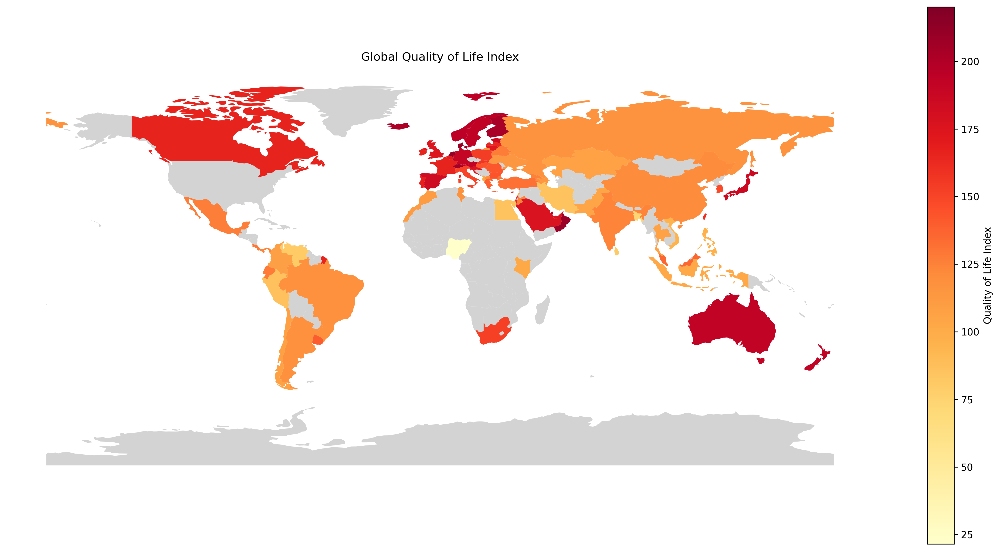

In [14]:
file_path ="natural_earth_data\\ne_110m_admin_0_countries.shp"
world = gpd.read_file(file_path)


print(world.columns)

merge_left_on = 'ADMIN'  
world = world.merge(df, how='left', left_on=[merge_left_on], right_on=['Country'])

fig, ax = plt.subplots(figsize=(20, 10))
world.plot(column='Quality of Life Index', 
          ax=ax,
          legend=True,
          legend_kwds={'label': 'Quality of Life Index'},
          missing_kwds={'color': 'lightgrey'},
          cmap='YlOrRd')

ax.axis('off')

plt.title('Global Quality of Life Index')
plt.show()

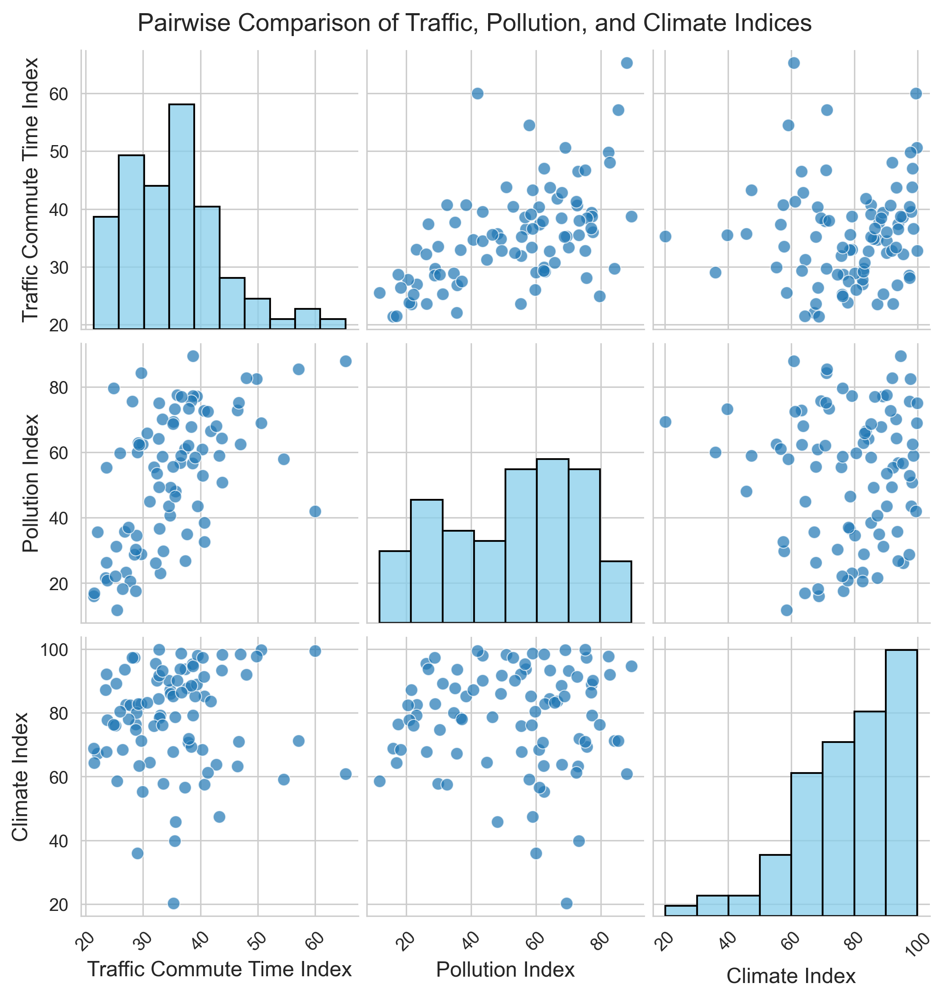

In [15]:
df_selected = df[['Traffic Commute Time Index', 'Pollution Index', 'Climate Index']]


sns.set_style("whitegrid") 
pairplot = sns.pairplot(df_selected, 
                         diag_kind="hist", 
                         plot_kws={'alpha': 0.7, 's': 50},
                         diag_kws={'color': 'skyblue', 'edgecolor': 'black'})

pairplot.fig.suptitle("Pairwise Comparison of Traffic, Pollution, and Climate Indices", 
                      fontsize=14, y=1.02)

for ax in pairplot.axes.flat:
    if ax:
        ax.set_xlabel(ax.get_xlabel(), fontsize=12)
        ax.set_ylabel(ax.get_ylabel(), fontsize=12)
        ax.xaxis.set_visible(True)
        ax.yaxis.set_visible(True)
        ax.tick_params(axis='x', rotation=45)
        ax.tick_params(axis='both', which='major', labelsize=10)

plt.show()


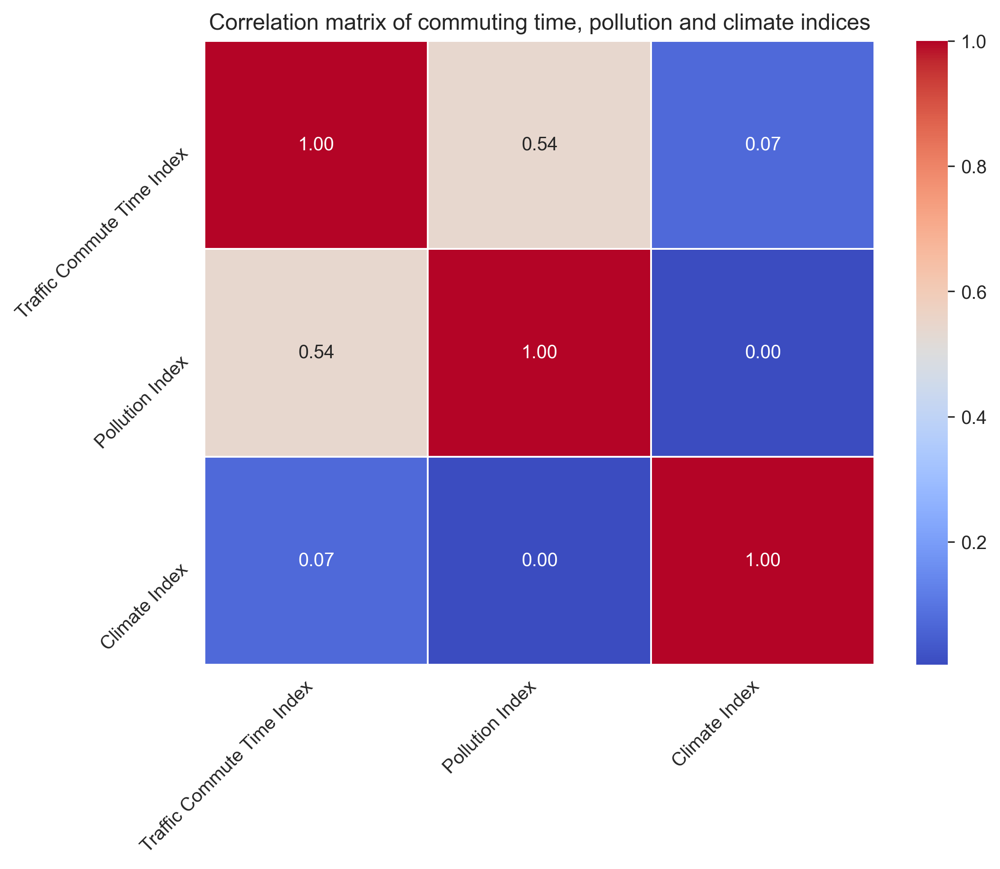

In [16]:
correlation_matrix = df_selected.corr()
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=45, va='top')
plt.title("Correlation matrix of commuting time, pollution and climate indices")
plt.show()

Group 1 (Purchasing Power Index, Cost of Living Index, Property Price to Income Ratio) Correlations:
Purchasing Power Index            0.882789
Cost of Living Index              0.736565
Property Price to Income Ratio   -0.663569
dtype: float64

Group 2 (Safety Index, Cost of Living Index) Correlations:
Safety Index            0.556305
Cost of Living Index    0.736565
dtype: float64


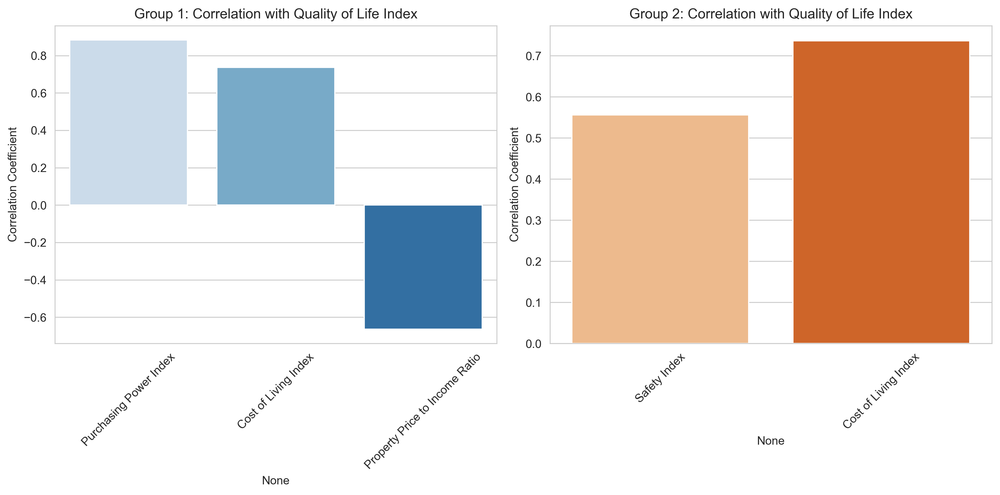

In [17]:
features_group_1 = ['Purchasing Power Index', 'Cost of Living Index', 'Property Price to Income Ratio']
features_group_2 = ['Safety Index', 'Cost of Living Index']

correlations_group_1 = df[features_group_1].corrwith(df['Quality of Life Index'])
correlations_group_2 = df[features_group_2].corrwith(df['Quality of Life Index'])

print("Group 1 (Purchasing Power Index, Cost of Living Index, Property Price to Income Ratio) Correlations:")
print(correlations_group_1)
print("\nGroup 2 (Safety Index, Cost of Living Index) Correlations:")
print(correlations_group_2)

plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
sns.barplot(x=correlations_group_1.index, y=correlations_group_1.values, palette="Blues")
plt.title("Group 1: Correlation with Quality of Life Index")
plt.ylabel("Correlation Coefficient")
plt.xticks(rotation=45)

plt.subplot(1, 2, 2)
sns.barplot(x=correlations_group_2.index, y=correlations_group_2.values, palette="Oranges")
plt.title("Group 2: Correlation with Quality of Life Index")
plt.ylabel("Correlation Coefficient")
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()

In [18]:
n_df=df[['Quality of Life Index','Purchasing Power Index','Pollution Index','Country']]

def classify_quality_of_life(index):
    if index >= 180:
        return "High (≥180)"
    elif 150 <= index < 180:
        return "Upper-Middle (150-179)"
    elif 120 <= index < 150:
        return "Middle (120-149)"
    elif 90 <= index < 120:
        return "Lower-Middle (90-119)"
    else:
        return "Low (<90)"

def classify_purchasing_power(index):
    if index >= 150:
        return "High (≥150)"
    elif 120 <= index < 150:
        return "Upper-Middle (120-149)"
    elif 90 <= index < 120:
        return "Middle (90-119)"
    elif 60 <= index < 90:
        return "Lower-Middle (60-89)"
    else:
        return "Low (<60)"

def classify_pollution(index):
    if index >= 70:
        return "High (≥70)"
    elif 50 <= index < 70:
        return "Upper-Middle (50-69)"
    elif 30 <= index < 50:
        return "Middle (30-49)"
    else:
        return "Low (<30)"

n_df["Quality of Life Category"] = n_df["Quality of Life Index"].apply(classify_quality_of_life)
n_df["Purchasing Power Category"] = n_df["Purchasing Power Index"].apply(classify_purchasing_power)
n_df["Pollution Category"] = n_df["Pollution Index"].apply(classify_pollution)

quality_counts = n_df["Quality of Life Category"].value_counts().reset_index()
quality_counts.columns = ["Category", "Count"]

purchasing_counts = n_df["Purchasing Power Category"].value_counts().reset_index()
purchasing_counts.columns = ["Category", "Count"]

pollution_counts = n_df["Pollution Category"].value_counts().reset_index()
pollution_counts.columns = ["Category", "Count"]

fig_quality = px.pie(quality_counts, values="Count", names="Category", title="Quality of Life Index Distribution")
fig_purchasing = px.pie(purchasing_counts, values="Count", names="Category", title="Purchasing Power Index Distribution")
fig_pollution = px.pie(pollution_counts, values="Count", names="Category", title="Pollution Index Distribution")

fig_quality.show()
fig_purchasing.show()
fig_pollution.show()

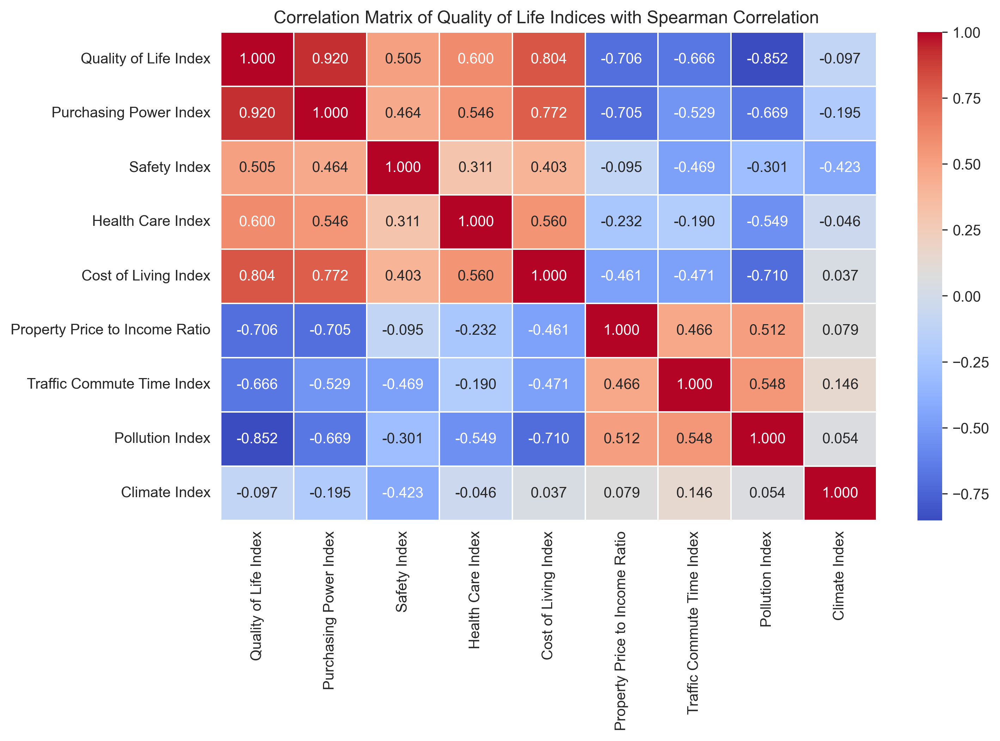

In [19]:
plt.figure(figsize=(10, 6))
sns.heatmap(df.iloc[:, 2:].corr(method='spearman'), annot=True, cmap="coolwarm", fmt=".3f", linewidths=0.5)
plt.title("Correlation Matrix of Quality of Life Indices with Spearman Correlation ")
plt.show()

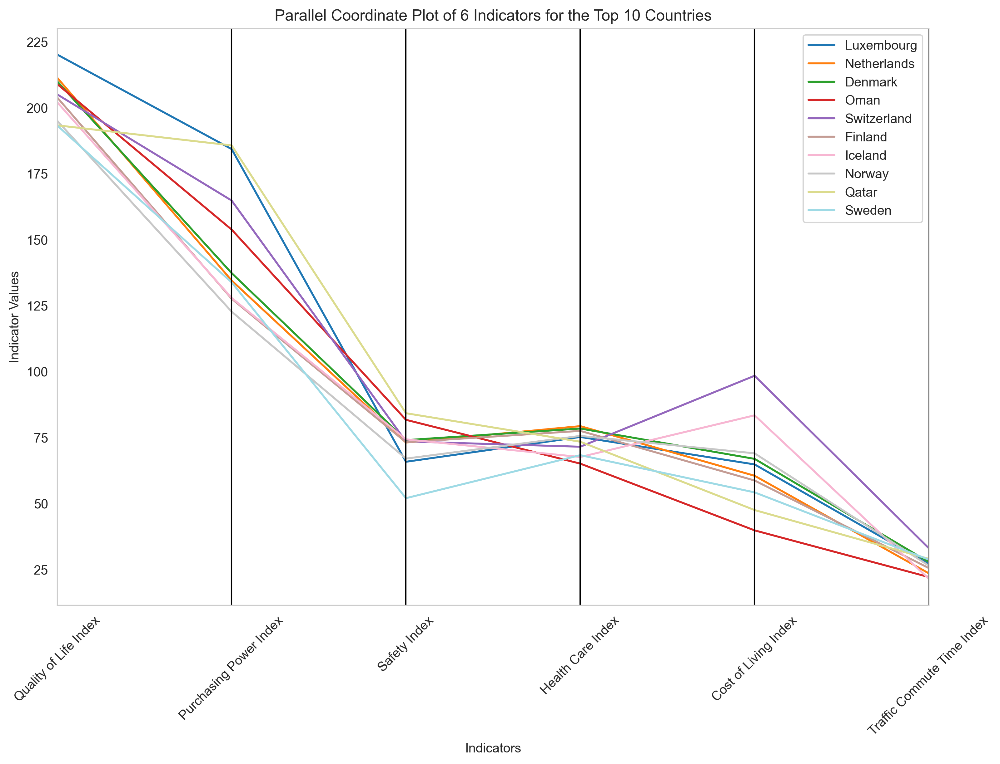

In [20]:
selected_df = df.head(10)[['Country', 'Quality of Life Index', 'Purchasing Power Index', 'Safety Index',
                           'Health Care Index', 'Cost of Living Index', 'Traffic Commute Time Index']]

plt.figure(figsize=(12, 8))


parallel_coordinates(selected_df, 'Country', colormap='tab20')


plt.title('Parallel Coordinate Plot of 6 Indicators for the Top 10 Countries')
plt.xlabel('Indicators')
plt.xticks(rotation=45)
plt.ylabel('Indicator Values')

plt.show()

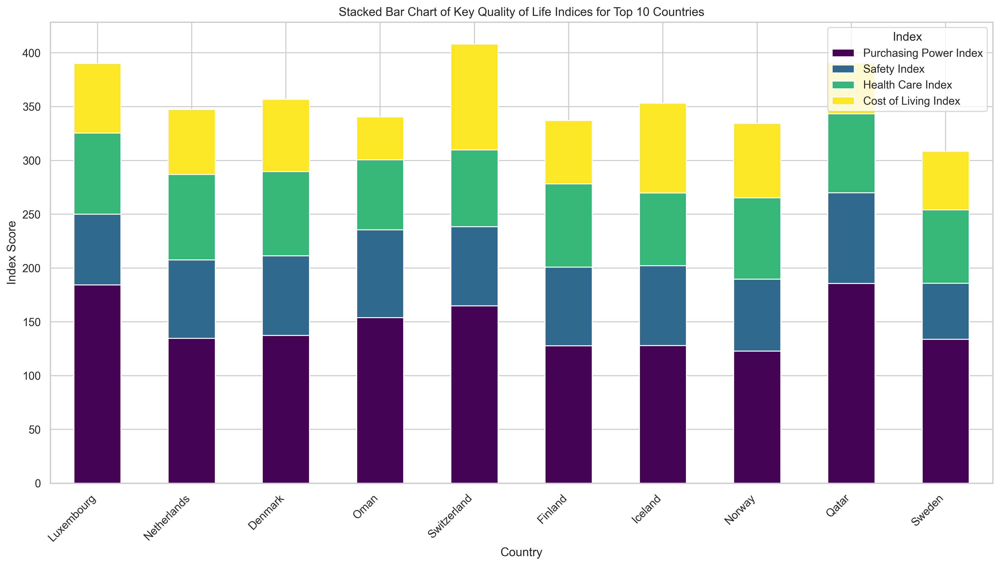

In [22]:
indices = ['Purchasing Power Index', 'Safety Index', 'Health Care Index', 'Cost of Living Index']
top_countries = df.head(10)
sns.set(style="whitegrid")
fig, ax = plt.subplots(figsize=(14, 8))
top_countries.set_index('Country')[indices].plot(kind='bar', stacked=True, ax=ax, colormap='viridis')
ax.set_title('Stacked Bar Chart of Key Quality of Life Indices for Top 10 Countries')
ax.set_xlabel('Country')
ax.set_ylabel('Index Score')
ax.legend(title='Index')
plt.xticks(rotation=45, ha='right') 
plt.tight_layout() 
plt.show()